In [ ]:
import equinox as eqx
import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
from optimistix import Solution, RESULTS
from jaxtyping import Array
import chromatix.functional as cf

from chromatix.field import crop
from einops import rearrange

from chromatix.experimental.diff_xnh.propagation import propagate
from chromatix.experimental.diff_xnh.sample import thin_sample, AbstractSample, Sample, empty_sample
from chromatix.experimental.diff_xnh.shift import shift_field, apply_shift
from chromatix.experimental.diff_xnh.source import generic_field
from chromatix.experimental.diff_xnh.post_processing import multi_paganin, register_shift
from chromatix.experimental.diff_xnh.magnification import magnification


from typing import Callable
import numpy as np
import jax.random as jr

key = jr.PRNGKey(42)


%config InlineBackend.figure_format='retina'

In [78]:
!uv pip install tifffile
import tifffile as tiff

!uv pip install opencv-python
!uv pip install xraylib

import xraylib
import cv2

Audited 1 package in 3ms


/groups/turaga/home/bothg/.local/share/uv/python/cpython-3.12.5-linux-x86_64-gnu/lib/python3.12/pty.py:95: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Resolved 2 packages in 130ms                                         
⠙ Preparing packages... (0/1)                                                   
⠙ Preparing packages... (0/1)-------     0 B/60.07 MiB                  
⠙ Preparing packages... (0/1)------- 16.00 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 32.00 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 48.00 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 62.41 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 78.41 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 94.41 KiB/60.07 MiB                
⠙ Preparing packages... (0/1)------- 110.41 KiB/60.07 MiB               
⠙ Preparing packages... (0/1)------- 126.41 KiB/60.07 MiB               
⠙ Preparing packages... (0/1)------- 142.41 KiB/60.07 MiB               
⠙ Preparing packages... (0/1)------- 158.41 KiB/60.07 MiB               
⠙ Preparing packages... (0/1)------- 174.41 Ki

In [2]:
# This little trick only works if we input a complex field, and take the grad
class CGState(eqx.Module):
    descent: Array
    grad: Array
    first_step: bool


def descent_fn(state, grad):
    # Finds the descent direction
    def initial_update_descent(state, grad):
        descent = jax.tree.map(lambda x: -x, grad)
        return CGState(descent, grad, False)

    def update_descent(state, grad):
        def dai_yuan(descent, grad, grad_prev):
            beta = jnp.sum(grad**2) / jnp.sum(descent * (grad - grad_prev))
            return -grad + beta * descent

        descent = jax.tree.map(dai_yuan, state.descent, grad, state.grad)
        return CGState(descent, grad, False)

    return jax.lax.cond(
        state.first_step, initial_update_descent, update_descent, state, grad
    )


def line_search(norm_fn, approx, forward_grad, decrease_factor, step_init):
    # Finds the optimal step_size
    def body_fn(carry):
        (step_size, idx, _) = carry
        estimate = jax.tree.map(lambda x, y: x + step_size * y, approx, forward_grad)
        diff = norm_fn(approx) - norm_fn(estimate)
        return (step_size * decrease_factor, idx + 1, diff)

    def cond_fn(carry):
        (step_size, _, diff) = carry
        return jnp.logical_and(diff < 0, step_size > 1 / 64)

    step_size, _, _ = jax.lax.while_loop(cond_fn, body_fn, (step_init, 0, -1.0))
    return step_size / decrease_factor


@eqx.filter_jit
def linear_cg(
    forward_fn: Callable,
    norm_fn: Callable,
    params: tuple,
    args: tuple = (),
    *,
    max_steps: int = 20,
    decrease_factor: float = 0.5,
    step_init: float = 0.5,
    state: CGState | None = None,
):
    def loss_fn(params, args):
        approx = forward_fn(params, args)
        return norm_fn(approx, args), approx

    def cg_step(step_idx, carry):
        params, state, losses = carry
        # Calculate the graident
        (loss, approx), grad = jax.value_and_grad(loss_fn, has_aux=True)(params, args)
        grad = jax.tree.map(
            lambda x: jnp.conj(x), grad
        )  # NOTE: with complex differentiation we need to take the conjugate

        # Get descent step
        state = descent_fn(state, grad)

        # Line search
        forward_grad = forward_fn(state.descent, args)
        step_size = line_search(
            lambda x: norm_fn(x, args), approx, forward_grad, decrease_factor, step_init
        )

        # Update parameters
        params = jax.tree.map(
            lambda x, descent: x + step_size * descent, params, state.descent
        )
        losses = losses.at[step_idx].set(loss)
        return (params, state, losses)

    if state is None:
        state = CGState(
            jax.tree.map(jnp.zeros_like, params),
            jax.tree.map(jnp.zeros_like, params),
            True,
        )
    params, state, losses = jax.lax.fori_loop(
        0, max_steps, cg_step, (params, state, jnp.zeros((max_steps,)))
    )

    return Solution(
        value=params,
        result=RESULTS.successful,
        aux=None,
        stats={"loss": losses},
        state=state,
    )


In [3]:
class Probe(eqx.Module):
    amplitude: Array
    phase: Array

    def __init__(
        self,
        *,
        amplitude: Array | None = None,
        phase: Array | None = None,
        field: Array | None = None,
    ):
        """Either give in phase and amplitude, or complex field"""
        match (amplitude, phase, field):
            case (None, None, _):
                field = rearrange(field, "h w -> 1 h w 1 1")
                self.amplitude = jnp.abs(field)
                self.phase = jnp.angle(field)

            case (_, _, None):
                self.amplitude = rearrange(amplitude, "h w -> 1 h w 1 1")
                self.phase = rearrange(phase, "h w -> 1 h w 1 1")

            case _:
                raise NotImplementedError()




In [4]:
class ProjectionConfig(eqx.Module):
    z_obj: Array
    angle: Array | None = None
    probe_shift: Array | None = None
    sample_shift: Array | None = None


class Beamline(eqx.Module):
    # Detector
    sensor_shape: tuple[int, int]
    pixel_pitch: float

    # Wavelength
    wavelength: float

    # distances
    z_total: float
    z_obj: Array

    # Padding
    N_pad_prop: int
    pad: int
    FoV: int

    def __init__(
        self,
        z_obj: Array,
        z_total: float,
        energy: float, # kEv
        sensor_shape: tuple[int, int],
        pixel_pitch: float,
        N_pad_prop: int | None = None,
        N_pad_sample: int | None = None,
    ):
        # Distances
        self.z_obj = z_obj
        self.z_total = z_total

        # wavelengths
        self.wavelength = 1.2398419840550367e-3 / energy

        # detector
        self.sensor_shape = sensor_shape
        self.pixel_pitch = pixel_pitch

        # Calculating sizes
        m_rel = self.z_ref / z_obj
        sample_size = sensor_shape[0]
        self.pad = sample_size // 16 if N_pad_sample is None else N_pad_sample
        FoV_float = (sample_size + 2 * self.pad) / m_rel[-1]
        self.FoV = int(np.ceil(FoV_float / 8) * 8)

        # Padding
        self.N_pad_prop = (
            (sample_size + 2 * self.pad) // 2 if N_pad_prop is None else N_pad_prop
        )

    def __call__(
        self, config: ProjectionConfig, sample: AbstractSample, probe: Probe
    ) -> Array:
        forward = eqx.filter_vmap(self.forward, in_axes=(0, None, None))
        return forward(config, sample, probe).u.squeeze()

    def forward(
        self, config: ProjectionConfig, sample: AbstractSample, probe: Probe
    ) -> cf.ScalarField:
        # Modified distances and magnifications
        m = self.z_total / config.z_obj
        m_rel = self.z_ref / config.z_obj

        # z_img_scaled
        z_img = self.z_total - config.z_obj
        z_img_scaled = z_img * m_rel**2 / m

        # z_obj_scaled
        z_obj_scaled = (config.z_obj - self.z_ref) * m_rel

        # Step 1a: making the probe field
        field = generic_field(
            dx=self.effective_resolution,
            spectrum=self.wavelength,
            spectral_density=1.0,
            amplitude=probe.amplitude,
            phase=probe.phase,
        )
        # Step 1b: shifting the probe
        if config.probe_shift is not None:
            field = shift_field(field, config.probe_shift)

        # Step 2: propagate probe field to right distance
        field = propagate(
            field,
            z=z_obj_scaled,
            N_pad=self.N_pad_prop,
        )

        # Step 3a: shift sample
        if config.sample_shift is not None:
            sample = sample.shift(config.sample_shift / m_rel)

        field = thin_sample(
            field,
            sample,
            config.angle,
            scale=m_rel * self.FoV / probe.amplitude.shape[1],
        )

        # Step 4: propagate field to detector
        field = propagate(field, z=z_img_scaled, N_pad=self.N_pad_prop)

        # Step 5: detector
        # We ignore the phase factor
        field = field.replace(_dx=field._dx * self.m_ref)
        return crop(field, self.pad)

    @property
    def z_ref(self):
        return self.z_obj[0]

    @property
    def m_ref(self):
        return self.z_total / self.z_ref

    @property
    def effective_resolution(self):
        return self.pixel_pitch / self.m_ref


In [5]:
# Setting up the model
z_total = 1.28e6
z_obj = jnp.array([4.584e3, 4.765e3, 5.488e3, 6.9895e3]) - 3.7e2
energy = 33.35  # kEV
sensor_shape = (
    1024,
    1024,
)  # NOTE: Change these to what you want, I set it like this for sample size.
pixel_pitch = 6.0
thickness = 2.0

model = Beamline(
    z_obj=z_obj,
    z_total=z_total,
    energy=energy,
    sensor_shape=sensor_shape,
    pixel_pitch=pixel_pitch,
)


# Loading probe
full_sample_size = model.FoV
probe_size = (
    sensor_shape[0] + 2 * model.pad
)  # NOTE: Not sure why this is not full sample size...

print(f"Full sample size: {model.FoV}")
print(f"Probe size: {probe_size}")

Full sample size: 1816
Probe size: 1152


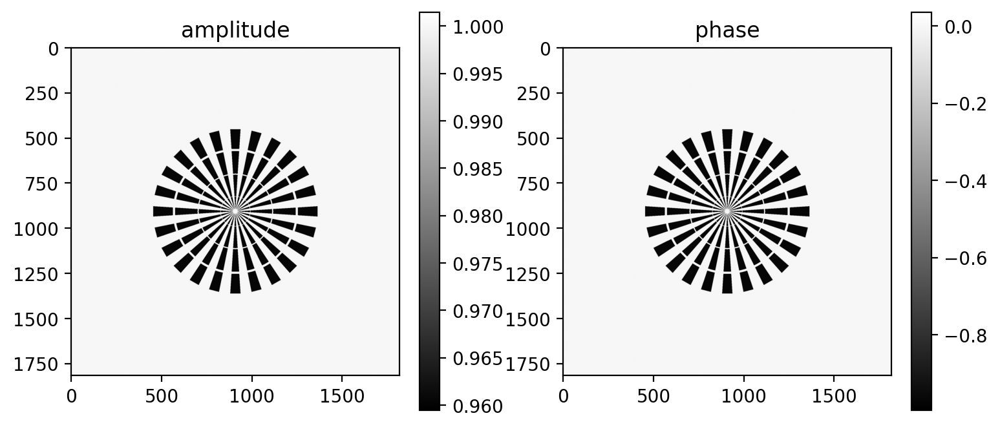

In [79]:
n = 1024  # object size in each dimension
ntheta = 1  # number of angles (rotations)

center = n/2  # rotation axis

# ID16a setup
ndist = 4

detector_pixelsize = 3e-6
energy = 33.35  # [keV] xray energy
wavelength = 1.2398419840550367e-09/energy  # [m] wave length

focusToDetectorDistance = 1.28  # [m]
sx0 = 3.7e-4
z1 = np.array([4.584e-3, 4.765e-3, 5.488e-3, 6.9895e-3])[:ndist]-sx0
z2 = focusToDetectorDistance-z1
distances = (z1*z2)/focusToDetectorDistance
magnifications = focusToDetectorDistance/z1
voxelsize = detector_pixelsize/magnifications[0]*2048/n  # object voxel size

norm_magnifications = magnifications/magnifications[0]
# scaled propagation distances due to magnified probes
distances = distances*norm_magnifications**2

z1p = z1[0]  # positions of the probe for reconstruction
z2p = z1-np.tile(z1p, len(z1))
# magnification when propagating from the probe plane to the detector
magnifications2 = (z1p+z2p)/z1p
# propagation distances after switching from the point source wave to plane wave,
distances2 = (z1p*z2p)/(z1p+z2p)
norm_magnifications2 = magnifications2/(z1p/z1[0])  # normalized magnifications
# scaled propagation distances due to magnified probes
distances2 = distances2*norm_magnifications2**2
distances2 = distances2*(z1p/z1)**2

# allow padding if there are shifts of the probe
pad = n//16
# sample size after demagnification
ne = int(np.ceil((n+2*pad)/norm_magnifications[-1]/8))*8  # make multiple of 8


img = np.zeros((ne, ne, 3), np.uint8)
triangle = np.array([(ne//4, ne//2-ne//64), (ne//4, ne//2+ne//64), (ne//2-ne//128, ne//2)], np.float32)
star = img[:,:,0]*0
for i in range(0, 360, 15):
    img = np.zeros((ne, ne, 3), np.uint8)
    degree = i
    theta = degree * np.pi / 180
    rot_mat = np.array([[np.cos(theta), -np.sin(theta)],
                        [np.sin(theta), np.cos(theta)]], np.float32)    
    rotated = cv2.gemm(triangle-ne//2, rot_mat, 1, None, 1, flags=cv2.GEMM_2_T)+ne//2
    cv2.fillPoly(img, [np.int32(rotated)], (255, 0, 0))
    star+=img[:,:,0]
[x,y] = np.meshgrid(np.arange(-ne//2,ne//2),np.arange(-ne//2,ne//2))
x = x/ne*2
y = y/ne*2
# add holes in triangles
circ = (x**2+y**2>0.145)+(x**2+y**2<0.135)
circ *= (x**2+y**2>0.053)+(x**2+y**2<0.05)
circ *= (x**2+y**2>0.0085)+(x**2+y**2<0.008)
star = star*circ/255

v = np.arange(-ne//2,ne//2)/ne
[vx,vy] = np.meshgrid(v,v)
v = np.exp(-5*(vx**2+vy**2))
fu = np.fft.fftshift(np.fft.fftn(np.fft.fftshift(star)))
star = np.fft.fftshift(np.fft.ifftn(np.fft.fftshift(fu*v))).real

delta = 1-xraylib.Refractive_Index_Re('Au',energy,19.3)
beta = xraylib.Refractive_Index_Im('Au',energy,19.3)

thickness = 2e-6/voxelsize # siemens star thickness in pixels
# form Transmittance function
u = star*(-delta+1j*beta) # note -delta
Ru = u*thickness 
psi = np.exp(1j * Ru * voxelsize * 2 * np.pi / wavelength)[np.newaxis].astype('complex64')
fig, axs = plt.subplots(1, 2, figsize=(9, 4))
im=axs[0].imshow(np.abs(psi[0]),cmap='gray')
axs[0].set_title('amplitude')
fig.colorbar(im)
im=axs[1].imshow(np.angle(psi[0]),cmap='gray')
axs[1].set_title('phase')
fig.colorbar(im)

In [86]:
# Generating sample
# Siemens for now, until Jakob gets here
delta = star * delta
# NOTE: We clip so beta > 0
beta = jnp.maximum(star * beta, 0.0)  
sample = Sample(delta, beta, thickness=2.0)

print(f"Sample size: {delta.shape}")

Sample size: (1816, 1816)


In [74]:
!wget -nc https://g-110014.fd635.8443.data.globus.org/holotomocupy/examples_synthetic/data/prb_id16a/prb_abs_2048.tiff -P docs/examples/data/prb_id16a
!wget -nc https://g-110014.fd635.8443.data.globus.org/holotomocupy/examples_synthetic/data/prb_id16a/prb_phase_2048.tiff -P docs/examples/data/prb_id16a

n = sensor_shape[0]
pad = model.pad

# Generating probe
prb_abs = tiff.imread('docs/examples/data/prb_id16a/prb_abs_2048.tiff')[0:1].squeeze()
prb_phase = tiff.imread('docs/examples/data/prb_id16a/prb_phase_2048.tiff')[0:1].squeeze()
prb = prb_abs * jnp.exp(1j * prb_phase)
prb = prb[512-pad:-512+pad, 512-pad:-512+pad]
prb /= np.mean(np.abs(prb))

v = jnp.arange(-(n+2*pad)//2,(n+2*pad)//2)/(n+2*pad)
[vx,vy] = np.meshgrid(v,v)
v=jnp.exp(-5*(vx**2+vy**2))
prb = jnp.fft.fftshift(jnp.fft.fftn(jnp.fft.fftshift(prb)))
prb = jnp.fft.fftshift(jnp.fft.ifftn(jnp.fft.fftshift(prb*v)))


probe = Probe(amplitude = jnp.abs(prb), phase = jnp.angle(prb))

File ‘docs/examples/data/prb_id16a/prb_abs_2048.tiff’ already there; not retrieving.

File ‘docs/examples/data/prb_id16a/prb_phase_2048.tiff’ already there; not retrieving.



In [51]:
# Generating measurements
# drift of the probe during collection of projections
shifts_probe = jr.uniform(key, (4, 2), minval=-0.5, maxval=0.5) * 1024 / 256

# drift of the probe during collection of references
# use the first ref image as the global reference for illumination
shifts_ref = jr.uniform(jr.split(key, 2)[0], (4, 2), minval=-0.5, maxval=0.5) * 1024 / 256
shifts_ref = shifts_ref.at[0].set(0.0)

# shift of the sample when moving between differen planes
# use the first plane as the global reference for illumination
shifts_sample = jnp.array([[0.0, 0.0], [0.6, 0.3], [-1.3, 1.5],[2.3, -3.5] ])


# Forward
config = ProjectionConfig(model.z_obj, probe_shift=shifts_probe, sample_shift=shifts_sample)
measurements = jnp.abs(eqx.filter_jit(model)(config, sample, probe))**2

# Flat field
config_ref = ProjectionConfig(model.z_obj, probe_shift=shifts_ref, sample_shift=None)
reference = jnp.abs(eqx.filter_jit(model)(config_ref, empty_sample(full_sample_size), probe))**2

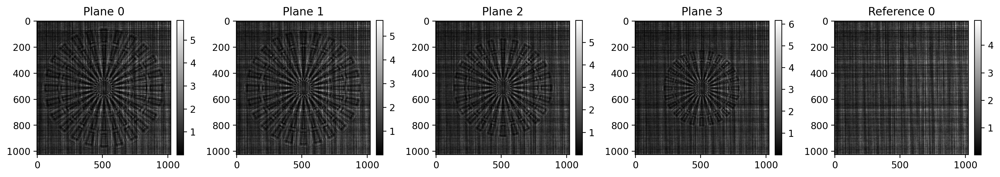

In [52]:
plt.figure(figsize=(15, 5), layout="tight")

plt.subplot(151)
plt.imshow(measurements[0], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 0")

plt.subplot(152)
plt.imshow(measurements[1], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 1")

plt.subplot(153)
plt.imshow(measurements[2], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 2")

plt.subplot(154)
plt.imshow(measurements[3], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Plane 3")

plt.subplot(155)
plt.imshow(reference[0], cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Reference 0")

plt.show()

In [53]:
# Finding the reference beam shifts
inferred_shift_ref = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, reference[0], 1000)))(reference)

print(f"Inferred shift of reference beams: \n{inferred_shift_ref}")
print(f"True shift of reference beams: \n{shifts_ref}")

Inferred shift of reference beams: 
[[-0.008      -0.008     ]
 [ 1.608       0.796     ]
 [ 0.446       0.46400002]
 [ 0.86399996 -1.167     ]]
True shift of reference beams: 
[[ 0.          0.        ]
 [ 1.6061211   0.7933316 ]
 [ 0.47226238  0.48740816]
 [ 0.87098694 -1.1611996 ]]


In [54]:
# Finding the reference beam shifts
inferred_shift_probe = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, reference[0], 1000)))(measurements)

print(f"Inferred shift of probe during projection: \n{inferred_shift_probe}")
print(f"True shift of probe during projection: \n{shifts_probe}")

Inferred shift of probe during projection: 
[[-0.04        0.717     ]
 [ 0.43300003  0.23      ]
 [-0.18900001  0.316     ]
 [-1.697       1.085     ]]
True shift of probe during projection: 
[[-0.04516172  0.7191887 ]
 [ 0.46508598  0.24406433]
 [-0.19742155  0.34346342]
 [-1.7007623   1.1005335 ]]


In [55]:
# We shift back the reference probes back to the reference position
# Note we can just shift over a negative distance
reference_aligned = jax.jit(jax.vmap(apply_shift))(reference, -inferred_shift_ref).real

# And then we shift them forward to the probe position during projections
inferred_probe_shifted = jax.jit(jax.vmap(apply_shift))(reference, inferred_shift_probe).real

In [56]:
# Part 1: Rescale to same size
m = z_total / z_obj
m_rel = m / m[0]
# Note: we divide by the inferred shifted probe 
rescaled_normed_measurements = jax.vmap(magnification)(measurements / inferred_probe_shifted, mag=1 / m_rel).real

In [57]:
# Part 2: Align based on images (not reconstructions)
inferred_shift_sample = jax.jit(jax.vmap(lambda imgs: register_shift(imgs, rescaled_normed_measurements[0], 1000)))(rescaled_normed_measurements)

norm_magnifications = (model.z_total / model.z_obj) / model.m_ref
inferred_shift_sample = inferred_shift_sample * norm_magnifications[:, None]

print(f"Inferred shift of sample during projection: \n{inferred_shift_sample}")
print(f"True shift of sample during projection: \n{shifts_sample}")

rescaled_normed_aligned_measurements = jax.jit(jax.vmap(apply_shift))(rescaled_normed_measurements, -inferred_shift_sample).real


Inferred shift of sample during projection: 
[[-0.009      -0.007     ]
 [ 0.40557954  0.45543805]
 [-1.1362486   1.4219575 ]
 [ 1.1127838  -2.3866286 ]]
True shift of sample during projection: 
[[ 0.   0. ]
 [ 0.6  0.3]
 [-1.3  1.5]
 [ 2.3 -3.5]]


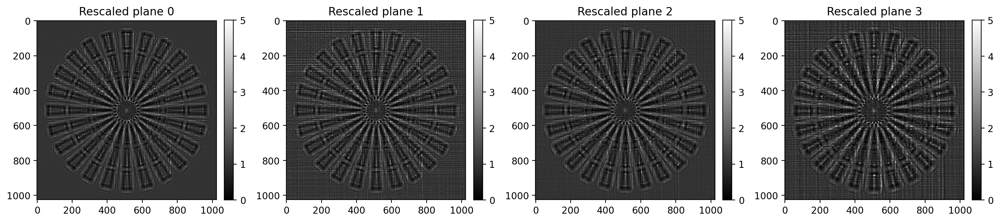

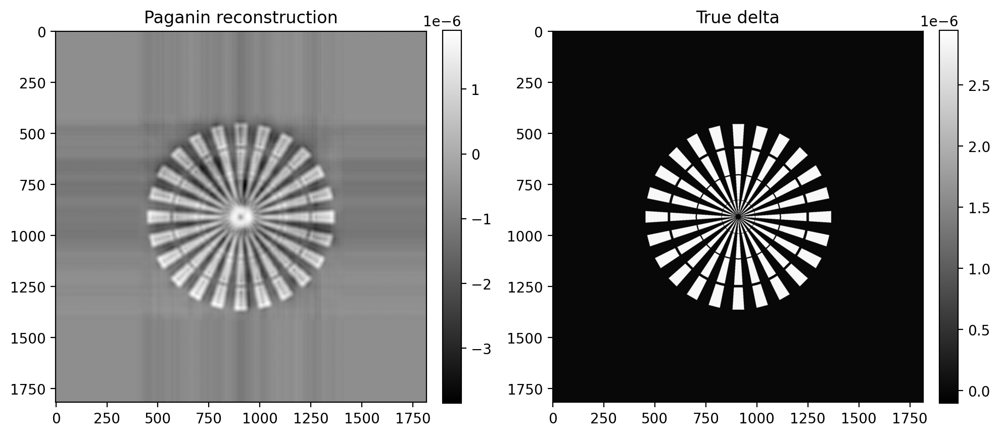

In [58]:
plt.figure(figsize=(15, 5), layout="tight")

plt.subplot(141)
plt.imshow(rescaled_normed_aligned_measurements[0], cmap="gray", vmin=0.0, vmax=5)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 0")


plt.subplot(142)
plt.imshow(rescaled_normed_aligned_measurements[1], cmap="gray", vmin=0.0, vmax=5)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 1")

plt.subplot(143)
plt.imshow(rescaled_normed_aligned_measurements[2], cmap="gray", vmin=0.0, vmax=5)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 2")

plt.subplot(144)
plt.imshow(rescaled_normed_aligned_measurements[3], cmap="gray", vmin=0.0, vmax=5)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Rescaled plane 3")

plt.show()


# Part: Multi paganin
z_img = z_total - z_obj
z_paganin = (z_obj * z_img) / z_total

dphi_paganin = multi_paganin(
    rescaled_normed_aligned_measurements,
    z_paganin,
    model.wavelength,
    model.effective_resolution,
    delta_beta=19.0,
)

# Padding to true sample size
n_sample_pad = (full_sample_size - sensor_shape[0]) // 2
dphi_paganin = jnp.pad(dphi_paganin, n_sample_pad, "edge")

# Turning dphi into delta & beta
k = 2 * jnp.pi / model.wavelength
delta_paganin = dphi_paganin.real / (k * thickness)
beta_paganin = dphi_paganin.imag / (k * thickness)

plt.figure(figsize=(10, 5), layout="tight")
plt.subplot(121)
plt.title("Paganin reconstruction")
plt.imshow(delta_paganin, cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)

plt.title("True delta")
plt.imshow(delta, cmap="gray")
plt.colorbar(fraction=0.046, pad=0.04)

plt.show()

In [59]:
# For the linear CG, we need two functions
# 1) A forward_fn, returning the output field (!!) - abs / intensity will break things
# 2) A norm fn, returning the loss between the forward_fn and something else
# Note that the forward_fn must be approximately linear in its parameters
def forward_fn(params, args):
    (probe_field, ) = params
    (_, config) = args
    probe = Probe(amplitude=jnp.abs(probe_field), phase=jnp.angle(probe_field))
    return model(config, empty_sample(full_sample_size), probe)

def norm_fn(approximate, args):
    (reference, _) = args
    # sum is the same as squared norm
    return 0.5 * jnp.sum((jnp.abs(approximate) - jnp.sqrt(reference))**2)

In [60]:
# We initialise like this
config_ref_inferred = ProjectionConfig(model.z_obj, probe_shift=inferred_shift_ref, sample_shift=None)
inferred_probe = jnp.ones((probe_size, probe_size), jnp.complex64)

solution = linear_cg(forward_fn, norm_fn, (inferred_probe, ), (reference, config_ref_inferred))
init_probe = Probe(amplitude=jnp.abs(solution.value[0]), phase=jnp.angle(solution.value[0]))

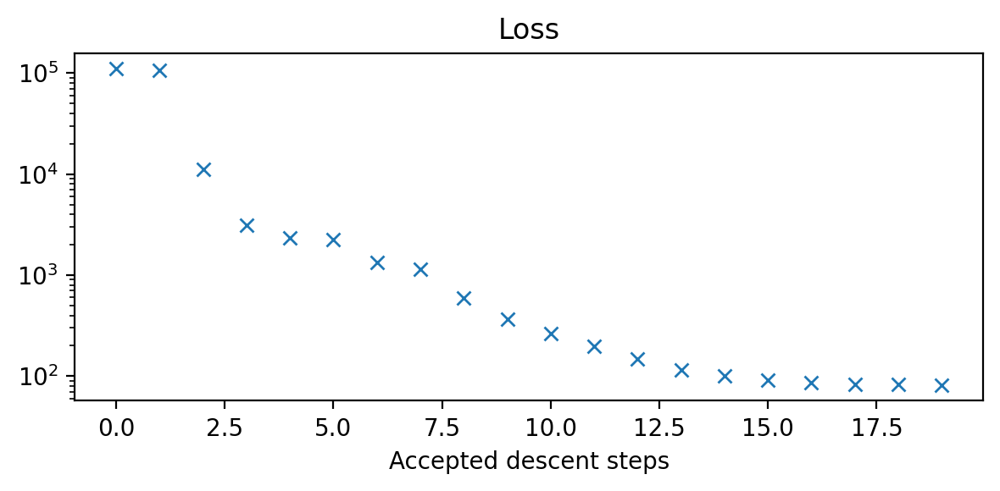

In [61]:
plt.figure(figsize=(6, 3), layout="tight")

plt.semilogy(solution.stats["loss"], 'x')
plt.title("Loss")
plt.xlabel("Accepted descent steps")

plt.show()

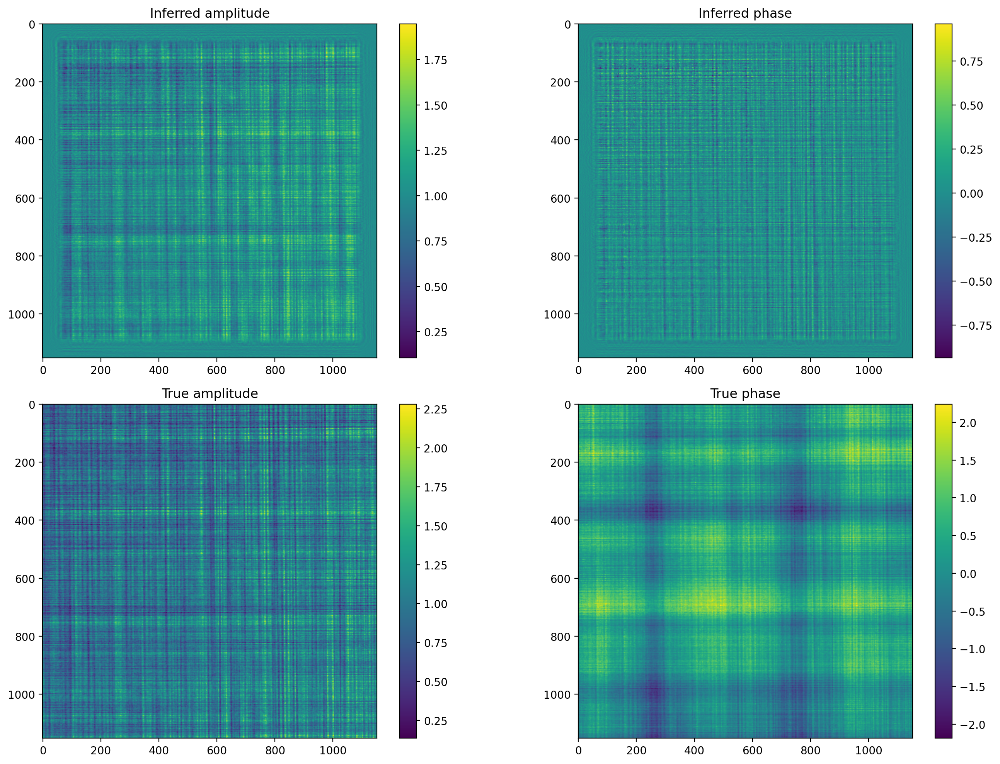

In [62]:
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(221)
plt.imshow(init_probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred amplitude")

plt.subplot(222)
plt.imshow(init_probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred phase")

plt.subplot(223)
plt.imshow(probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True amplitude")

plt.subplot(224)
plt.imshow(probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True phase")

plt.show()

Text(0.5, 1.0, 'Cross section of phase')

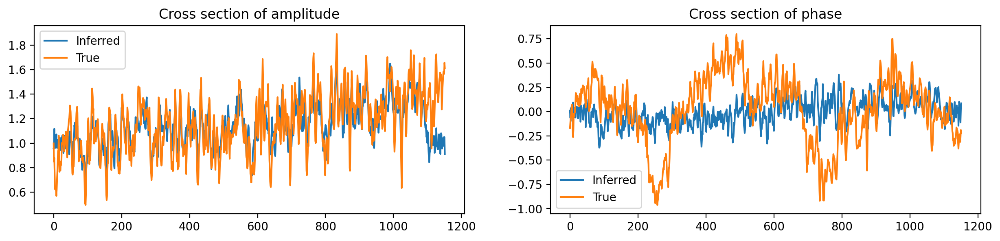

In [63]:
plt.figure(figsize=(15, 3))

plt.subplot(121)
plt.plot(init_probe.amplitude.squeeze()[576], label="Inferred")
plt.plot(probe.amplitude.squeeze()[576], label="True")
plt.legend()
plt.title("Cross section of amplitude")


plt.subplot(122)
plt.plot(init_probe.phase.squeeze()[576], label="Inferred")
plt.plot(probe.phase.squeeze()[576], label="True")
plt.legend()
plt.title("Cross section of phase")

In [64]:
# Learning sample function
def forward_fn_sample(params, args):
    (sample_field, ) = params
    (_, probe_field, config) = args

    # Making probe
    probe = Probe(amplitude=jnp.abs(probe_field), phase=jnp.angle(probe_field))


    # We do this here because we optimise the field change due to the sample; not the sample itself.
    # This makes the loss function approximately linear in the sample, and we can use the much faster
    # linear CG method.  
    delta = -jnp.log(sample_field + 1e-8).imag / (thickness * 2 * jnp.pi) * model.wavelength
    beta = -jnp.log(sample_field + 1e-8).real / (thickness * 2 * jnp.pi) * model.wavelength
    sample = Sample(delta = delta, beta=beta, thickness=thickness)


    return model(config, sample, probe)

def norm_fn_sample(approximate, args):
    (measurements, _, _) = args
    # sum is the same as squared norm
    return 0.5 * jnp.sum((jnp.abs(approximate) - jnp.sqrt(measurements))**2)


def forward_fn_probe(params, args):
    (probe_field, ) = params
    (_, _, sample_field, config, config_ref) = args
    # Making probe
    probe = Probe(amplitude=jnp.abs(probe_field), phase=jnp.angle(probe_field))
    
    # Making sample
    delta = -jnp.log(sample_field + 1e-8).imag / (thickness * 2 * jnp.pi) * model.wavelength
    beta = -jnp.log(sample_field + 1e-8).real / (thickness * 2 * jnp.pi) * model.wavelength
    sample = Sample(delta = delta, beta=beta, thickness=thickness)

    return (model(config, sample, probe), model(config_ref, empty_sample(full_sample_size), probe))

def norm_fn_probe(approximate, args):
    sample_approximate, reference_approximate = approximate
    (measurements, reference, _, _, _) = args
    # sum is the same as squared norm
    return 0.5 * jnp.sum((jnp.abs(sample_approximate) - jnp.sqrt(measurements))**2) + 0.5 * jnp.sum((jnp.abs(reference_approximate) - jnp.sqrt(reference))**2)

In [67]:
# We initialise like this
config_inferred = ProjectionConfig(model.z_obj, probe_shift=inferred_shift_probe, sample_shift=inferred_shift_sample)
probe_field = init_probe.amplitude.squeeze() * jnp.exp(1j * init_probe.phase.squeeze())
sample_field = jnp.exp(-1j * 2 * jnp.pi / model.wavelength * (delta_paganin -1j * beta_paganin))

n_steps = 15 # the performance decays after 24 steps!
solver_sample_state, solver_probe_state = None, None
stats_sample, stats_probe = [], []
for idx in range(n_steps):
    # Take a few steps in the sample direction
    solution = linear_cg(forward_fn_sample, norm_fn_sample, (sample_field, ), (measurements, probe_field, config_inferred), max_steps=1, state=solver_sample_state)
    sample_field = solution.value[0]
    solver_sample_state = solution.state
    stats_sample.append(solution.stats["loss"])

     # Take a few steps in the sample direction
    solution = linear_cg(forward_fn_probe, norm_fn_probe, (probe_field, ), (measurements, reference, sample_field, config_inferred, config_ref_inferred), max_steps=1, state=solver_probe_state)
    probe_field = solution.value[0]
    solver_probe_state = solution.state
    stats_probe.append(solution.stats["loss"])
    print(f"Finished step {idx}")


# Turning it back into probe / sample for easier plotting
inferred_probe = Probe(amplitude=jnp.abs(probe_field), phase=jnp.angle(probe_field))
inferred_delta = -jnp.log(sample_field + 1e-8).imag / (thickness * 2 * jnp.pi) * model.wavelength
inferred_beta = -jnp.log(sample_field + 1e-8).real / (thickness * 2 * jnp.pi) * model.wavelength
inferred_sample = Sample(delta = inferred_delta, beta=inferred_beta, thickness=thickness)

Finished step 0
Finished step 1
Finished step 2
Finished step 3
Finished step 4
Finished step 5
Finished step 6
Finished step 7
Finished step 8
Finished step 9
Finished step 10
Finished step 11
Finished step 12
Finished step 13
Finished step 14


Text(0.5, 1.0, 'Probe loss')

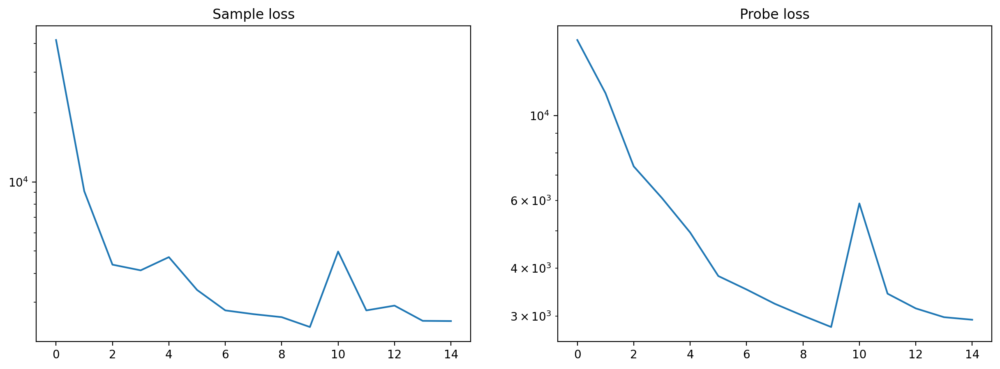

In [68]:
loss_sample = jnp.concat(stats_sample)
loss_probe = jnp.concat(stats_probe)

plt.figure(figsize=(15, 5))
plt.subplot(121)
plt.semilogy(loss_sample)
plt.title("Sample loss")

plt.subplot(122)
plt.semilogy(loss_probe)
plt.title("Probe loss")

Text(0.5, 1.0, 'True beta')

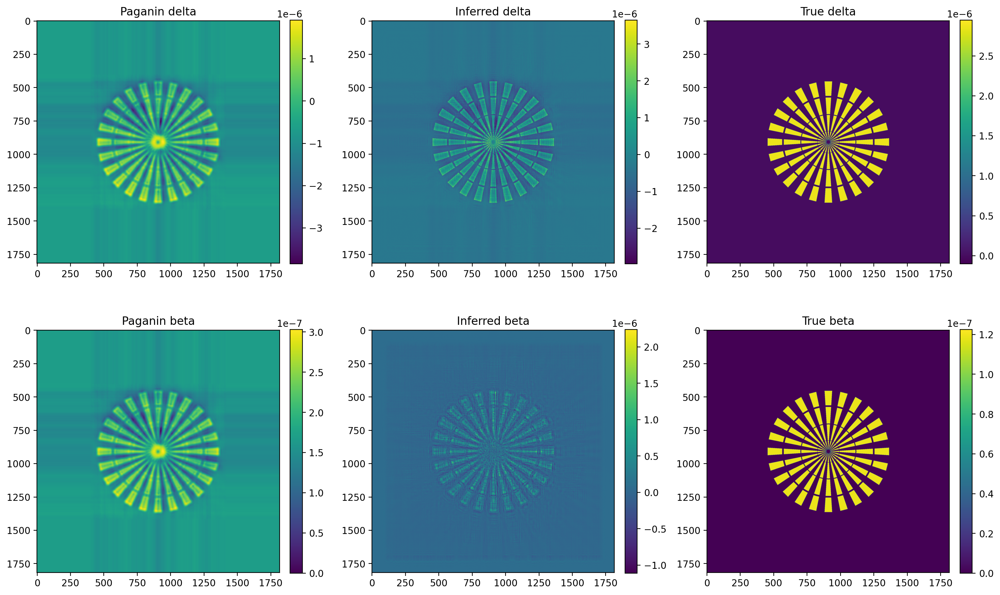

In [69]:
# NOTE: This looks pretty similar to holotomocupy
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(231)
plt.imshow(delta_paganin.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Paganin delta")

plt.subplot(232)
plt.imshow(inferred_sample.delta.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred delta")

plt.subplot(233)
plt.imshow(delta)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True delta")

plt.subplot(234)
plt.imshow(beta_paganin.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Paganin beta")

plt.subplot(235)
plt.imshow(inferred_sample.beta.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred beta")

plt.subplot(236)
plt.imshow(beta)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True beta")

Text(0.5, 1.0, 'True phase')

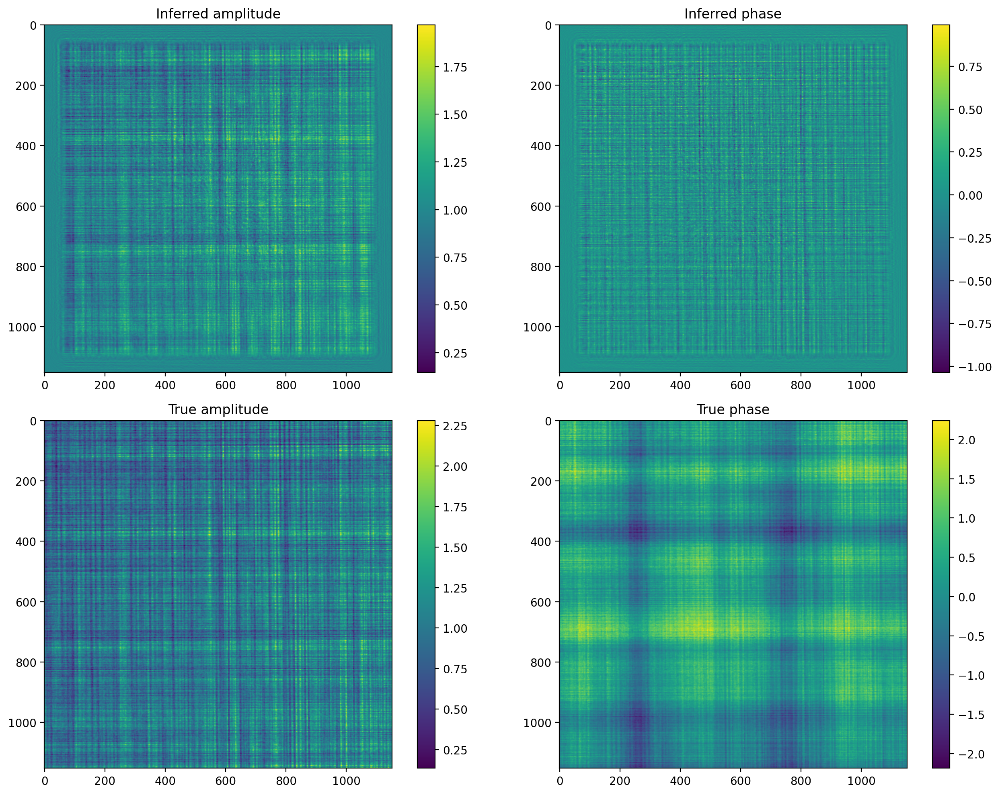

In [70]:
# NOTE: This looks pretty similar to holotomocupy
plt.figure(figsize=(15, 10), layout="tight")

plt.subplot(221)
plt.imshow(inferred_probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred amplitude")

plt.subplot(222)
plt.imshow(inferred_probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("Inferred phase")

plt.subplot(223)
plt.imshow(probe.amplitude.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True amplitude")

plt.subplot(224)
plt.imshow(probe.phase.squeeze())
plt.colorbar(fraction=0.046, pad=0.04)
plt.title("True phase")

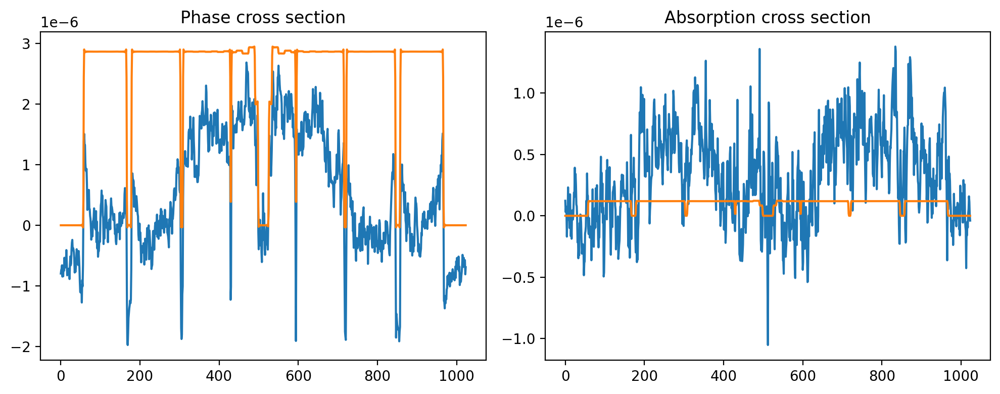

In [62]:
plt.figure(figsize=(10, 4), layout="tight")
plt.subplot(121)
plt.title("Phase cross section")
plt.plot(inferred_sample.delta.squeeze()[396:-396, 396:-396][512])
plt.plot(delta.squeeze()[396:-396, 396:-396][512])


plt.subplot(122)
plt.title("Absorption cross section")
plt.plot(inferred_sample.beta.squeeze()[396:-396, 396:-396][512])
plt.plot(beta.squeeze()[396:-396, 396:-396][512])


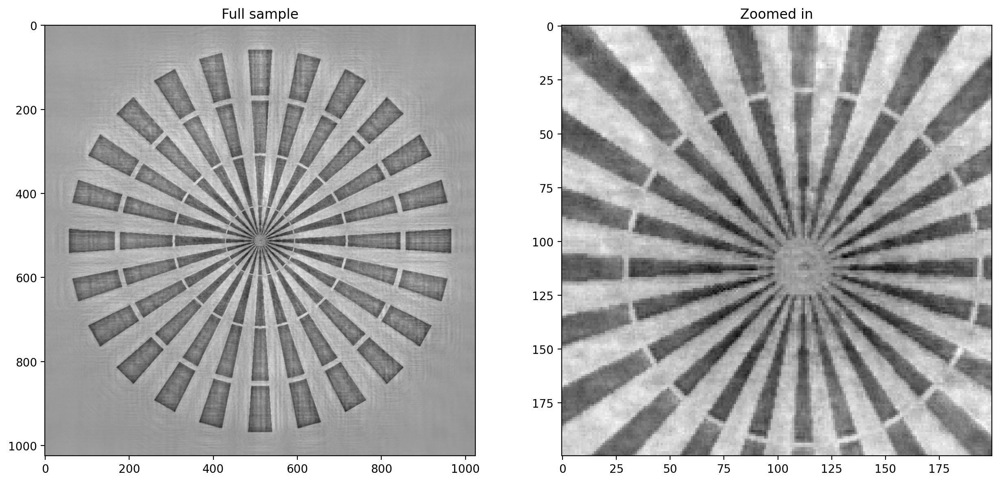

In [71]:
plt.figure(figsize=(15, 7))

plt.subplot(121)
plt.title("Full sample")
plt.imshow(inferred_sample.delta.squeeze()[396:-396, 396: -396], cmap="gray_r")

plt.subplot(122)
plt.title("Zoomed in")
plt.imshow(inferred_sample.delta.squeeze()[396:-396, 396: -396][400:600, 400:600], cmap="gray_r")

plt.show()